# Learning Functions

Implementation of the simple function learning experiment carried out in section 4.1 of [*Neural Arithmetic Logic Units*](https://arxiv.org/abs/1808.00508).

Functions learned:

* Addition
* Subtraction
* Multiplication
* Division
* Sqrt
* Square

In [1]:
# Load environment
using Pkg
Pkg.activate("..")

"/Users/domluna/github/NeuralArithmetic/Project.toml"

In [2]:
using NeuralArithmetic
using Flux
using Plots
using DataFrames
import Distributions: Uniform

┌ Info: Recompiling stale cache file /Users/domluna/.julia/compiled/v1.0/NeuralArithmetic/B9sGZ.ji for NeuralArithmetic [77cec1ae-a0aa-11e8-15c8-b1760286d022]
└ @ Base loading.jl:1184
Expr(:block, #= Symbol("/Users/domluna/.julia/packages/Flux/VzKHW/src/tracker/array.jl"):399 =#, Expr(:function, Expr(:where, Expr(:call, :flatten, Expr(:::, :bc, Expr(:curly, :Broadcasted, :Style))), :Style), Expr(:block, #= Symbol("/Users/domluna/.julia/packages/Flux/VzKHW/src/tracker/array.jl"):400 =#, Expr(:&&, Expr(:call, :isflat, :bc), Expr(:return, :bc)), #= Symbol("/Users/domluna/.julia/packages/Flux/VzKHW/src/tracker/array.jl"):401 =#, :args = Expr(:call, :cat_nested, :bc), #= Symbol("/Users/domluna/.julia/packages/Flux/VzKHW/src/tracker/array.jl"):402 =#, Expr(:let, Expr(:block, :makeargs = Expr(:call, :make_makeargs, :bc), :f = Expr(:., :bc, :(:f))), Expr(:block, #= Symbol("/Users/domluna/.julia/packages/Flux/VzKHW/src/tracker/array.jl"):403 =#, :newf = Expr(:macrocall, Symbol("@inline"), #= Sy

loaded


In [3]:
# number of training set examples
N = 500

500

The dataset of a function will contain `N` training examples, 100 validation examples (interpolation), and 100 testing examples (extrapolation).

The examples are sampled for a uniform distribution and then scaled to a larger range, the extrapolation range is larger than the interpolation range.

In [12]:
struct Dataset{F}
    f::F
    input_dim::Int
    train
    val # interpolation data
    test # extrapolation data
end

function gen_data_binary(f::F, n::Int, irange, erange) where {F}
    idist = Uniform(irange[1], irange[2])
    edist = Uniform(erange[1], erange[2])
    train_X = rand(idist, 2, n)
    train_y = f.(train_X[1, :], train_X[2, :])
    val_X = rand(idist, 2, 50)
    val_y = f.(val_X[1, :], val_X[2, :])
    test_X = rand(edist, 2, 100)
    test_y = f.(test_X[1, :], test_X[2, :])
    return Dataset(f, 2, (train_X, train_y), (val_X, val_y), (test_X, test_y))
end

function gen_data_unary(f::F, n::Int, irange, erange) where {F}
    idist = Uniform(irange[1], irange[2])
    edist = Uniform(erange[1], erange[2])
    train_X = rand(idist, 1, n)
    train_y = f.(train_X[1, :])
    val_X = rand(idist, 1, 50)
    val_y = f.(val_X[1, :])
    test_X = rand(edist, 1, 100)
    test_y = f.(test_X[1, :])
    return Dataset(f, 1, (train_X, train_y), (val_X, val_y), (test_X, test_y))
end



gen_data_unary (generic function with 3 methods)

In [14]:
square = (x) -> ^(x, 2)

add_data = gen_data_binary(+, N, (1, 5), (1, 20))
sub_data = gen_data_binary(-, N, (1, 5), (1, 20))
div_data = gen_data_binary(/, N, (1, 5), (1, 20))
mul_data = gen_data_binary(*, N, (1, 5), (1, 20))
sqrt_data = gen_data_unary(sqrt, N, (1, 5), (1, 20))
square_data = gen_data_unary(square, N, (1, 5), (1, 20))

datasets = Dict(
    "add" => add_data,
    "sub" => sub_data,
    "div" => div_data,
    "mul" => mul_data,
    "sqrt" => sqrt_data,
    "square" => square_data,
)

Dict{String,Dataset} with 6 entries:
  "add"    => Dataset{typeof(+)}(+, 2, ([1.4676 3.4117 … 1.8309 1.40367; 1.1932…
  "sub"    => Dataset{typeof(-)}(-, 2, ([4.6279 3.56985 … 3.01645 1.35768; 3.77…
  "div"    => Dataset{typeof(/)}(/, 2, ([4.49494 4.60438 … 3.90494 4.27018; 4.6…
  "mul"    => Dataset{typeof(*)}(*, 2, ([4.38401 4.05041 … 1.11627 1.77557; 4.9…
  "sqrt"   => Dataset{typeof(sqrt)}(sqrt, 1, ([3.12283 4.45588 … 4.13519 1.9796…
  "square" => Dataset{##43#44}(##43#44(), 1, ([1.55149 1.32983 … 4.97094 2.4171…

Models we'll use in the experiments:

In [15]:
relu6(x) = min.(max.(x, 0.0), 6.0)

linear_model = (input_dim) -> Chain(Dense(input_dim, 2), Dense(2, 1))
relu6_model = (input_dim) -> Chain(Dense(input_dim, 2, relu6), Dense(2, 1))
nac_model = (input_dim) -> Chain(NAC(input_dim, 2), NAC(2, 1))
nalu_model = (input_dim) -> Chain(NALU(input_dim, 2), NALU(2, 1))

#51 (generic function with 1 method)

`train_model` trains the model are records interpolation and extrapolation losses.

`run_experiment` trains a separate model for each dataset and accumulates the results in `DataFrame`s.

In [16]:
loss(m) = (x, y) -> Flux.mse(m(x), y')

function train_model(model, opt, ds::Dataset, epochs::Int, print_interval::Int)
    lossf = loss(model)
    hist = Array{Float64}(undef, 2, epochs)
    for i in 1:epochs
        Flux.train!(lossf, [ds.train], opt)
        val_loss = Flux.data(lossf(ds.val...))
        test_loss = Flux.data(lossf(ds.test...))
        if print_interval != -1 && i % print_interval == 0
            @info "Iteration $i, validation loss = $val_loss"
        end
        hist[1, i] = val_loss
        hist[2, i] = test_loss
    end
    return hist
end

function run_experiment(modelf, datasets::Dict{String, Dataset}, epochs::Int=1000, print_interval::Int=-1)
    interpolation_df = DataFrame()
    extrapolation_df = DataFrame()
    for (name, ds) in datasets
        m = modelf(ds.input_dim)
        opt = ADAM(Flux.params(m))
        hist = train_model(m, opt, ds, epochs, print_interval)
        interpolation_df[Symbol(name)] = hist[1, :]
        extrapolation_df[Symbol(name)] = hist[2, :]
        @info "Done evaluation dataset $name"
    end
    return interpolation_df, extrapolation_df
end

run_experiment (generic function with 3 methods)

Let's run the experiments and plot results.

In [17]:
epochs = 10_000
# print_interval = 100

10000

┌ Info: Done evaluation dataset add
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[16]:28
┌ Info: Done evaluation dataset div
└ @ Main In[16]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[16]:28
┌ Info: Done evaluation dataset square
└ @ Main In[16]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 3.57646e-23), (:sub, 2.85469e-31), (:div, 0.0952361), (:mul, 0.996779), (:sqrt, 0.00121826), (:square, 1.74581)]
└ @ Main In[18]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 3.18324e-21), (:sub, 2.51691e-29), (:div, 8.25879), (:mul, 8489.54), (:sqrt, 1.40297), (:square, 12246.5)]
└ @ Main In[18]:10


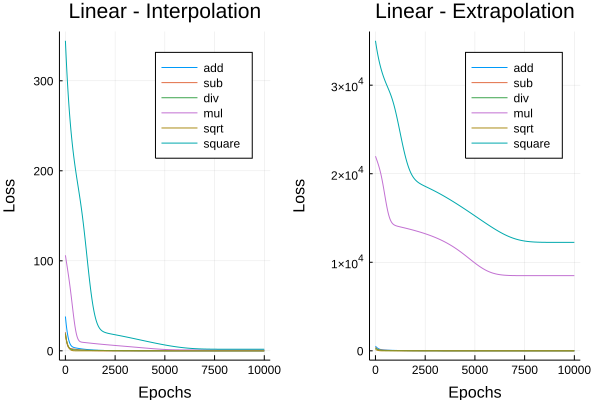

In [18]:
df1, df2 = run_experiment(linear_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="Linear - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="Linear - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

ReLU6 model.

┌ Info: Done evaluation dataset add
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[16]:28
┌ Info: Done evaluation dataset div
└ @ Main In[16]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[16]:28
┌ Info: Done evaluation dataset square
└ @ Main In[16]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 2.81039), (:sub, 2.28499e-9), (:div, 0.0952361), (:mul, 0.306165), (:sqrt, 0.00121826), (:square, 0.493645)]
└ @ Main In[19]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 271.282), (:sub, 13.3151), (:div, 8.00561), (:mul, 17770.0), (:sqrt, 1.24887), (:square, 22765.8)]
└ @ Main In[19]:10


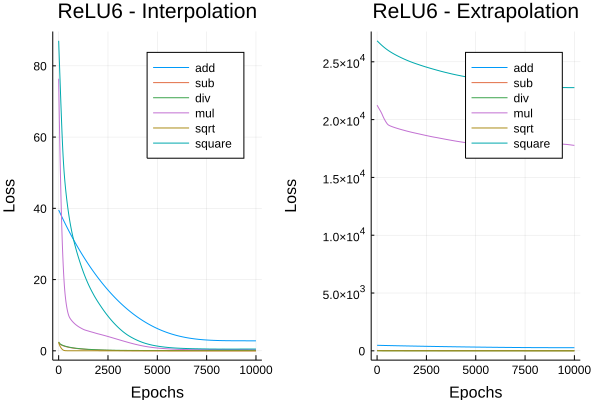

In [19]:
df1, df2 = run_experiment(relu6_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="ReLU6 - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="ReLU6 - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

NAC model.

┌ Info: Done evaluation dataset add
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[16]:28
┌ Info: Done evaluation dataset div
└ @ Main In[16]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[16]:28
┌ Info: Done evaluation dataset square
└ @ Main In[16]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 1.886e-10), (:sub, 5.18768e-31), (:div, 0.0952361), (:mul, 2.82482), (:sqrt, 0.00121826), (:square, 27.5321)]
└ @ Main In[20]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 1.69307e-8), (:sub, 4.13651e-29), (:div, 8.25879), (:mul, 11689.4), (:sqrt, 1.40297), (:square, 20967.5)]
└ @ Main In[20]:10


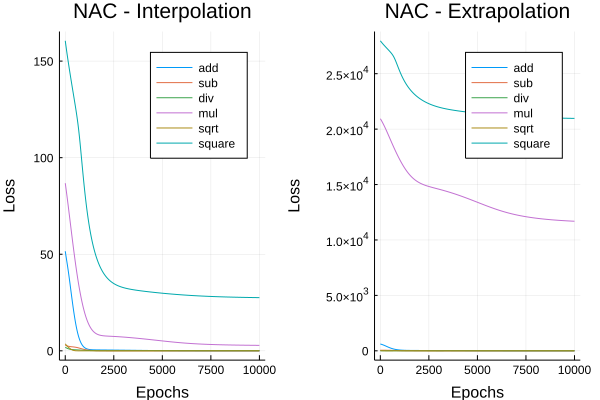

In [20]:
df1, df2 = run_experiment(nac_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="NAC - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="NAC - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)

NALU model.

┌ Info: Done evaluation dataset add
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sub
└ @ Main In[16]:28
┌ Info: Done evaluation dataset div
└ @ Main In[16]:28
┌ Info: Done evaluation dataset mul
└ @ Main In[16]:28
┌ Info: Done evaluation dataset sqrt
└ @ Main In[16]:28
┌ Info: Done evaluation dataset square
└ @ Main In[16]:28
┌ Info: Interpolation final losses: Tuple{Symbol,Float64}[(:add, 0.000718365), (:sub, 0.0055347), (:div, 3.1825e-5), (:mul, 0.00816866), (:sqrt, 3.93686e-7), (:square, 0.0302743)]
└ @ Main In[21]:3
┌ Info: Extrapolation final losses: Tuple{Symbol,Float64}[(:add, 30.8288), (:sub, 44.5316), (:div, 2.9803), (:mul, 3208.88), (:sqrt, 0.0315157), (:square, 3850.5)]
└ @ Main In[21]:10


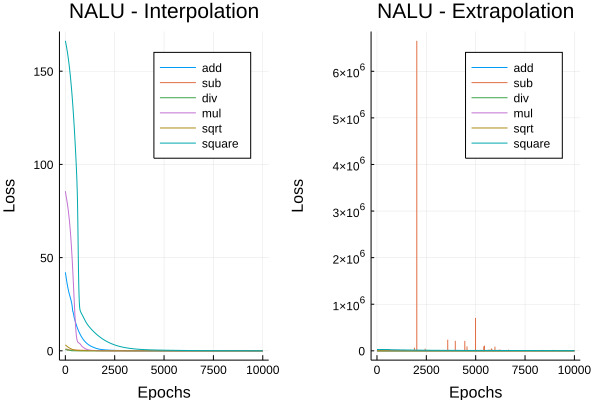

In [21]:
df1, df2 = run_experiment(nalu_model, datasets, epochs)

@info "Interpolation final losses: $([(name, df1[name][end]) for name in names(df1)])"
p1 = plot(1:epochs, [df1[name] for name in names(df1)], 
    title="NALU - Interpolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df1)])

@info "Extrapolation final losses: $([(name, df2[name][end]) for name in names(df2)])"
p2 = plot(1:epochs, [df2[name] for name in names(df2)], 
    title="NALU - Extrapolation",
    xlabel="Epochs",
    ylabel="Loss",
    labels=[String.(name) for name in names(df2)])

plot(p1, p2)